# Скачивание и установка модулей

In [ ]:
import os

In [ ]:
!wget https://storage.yandexcloud.net/academy.ai/watermarked.zip
!unzip -qo "watermarked.zip" -d ./watermarked

--2024-09-01 19:45:54--  https://storage.yandexcloud.net/academy.ai/watermarked.zip
Resolving storage.yandexcloud.net (storage.yandexcloud.net)... 213.180.193.243, 2a02:6b8::1d9
Connecting to storage.yandexcloud.net (storage.yandexcloud.net)|213.180.193.243|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 731796045 (698M) [application/x-zip-compressed]
Saving to: ‘watermarked.zip’

watermarked.zip     100%[===================>] 697.89M  8.30MB/s    in 89s     

2024-09-01 19:47:24 (7.87 MB/s) - ‘watermarked.zip’ saved [731796045/731796045]



# Задаем пути к папкам

In [ ]:
# Задаем пути к папкам
train_path = './watermarked/wm-nowm/train' # тренировочные образцы
valid_path = './watermarked/wm-nowm/valid' # контрольные образцы

import shutil
# Удаляем картики с водными знаками
shutil.rmtree(os.path.join(train_path, 'watermark'))
shutil.rmtree(os.path.join(valid_path, 'watermark'))

# Задаем пути к папкам
train_path_no = os.path.join(train_path, 'no-watermark')
valid_path_no = os.path.join(valid_path, 'no-watermark')

In [ ]:
# @title Отбираем парные картинки

# список файлов без водяных знаков (тренировочная выборка)
train_nonwatermarked = [os.path.join(train_path_no, f) for f in os.listdir(train_path_no) if os.path.isfile(os.path.join(train_path_no, f))]

# список файлов без водяных знаков (контрольная выборка)
valid_nonwatermarked = [os.path.join(valid_path_no, f) for f in os.listdir(valid_path_no) if os.path.isfile(os.path.join(valid_path_no, f))]

print('Обучающая выборка содержит:')
print(len(train_nonwatermarked), 'файлов без водяных знаков')

print('Контрольная выборка содержит:')
print(len(valid_nonwatermarked), 'файлов без водяных знаков')

Обучающая выборка содержит:
12477 файлов без водяных знаков
Контрольная выборка содержит:
3289 файлов без водяных знаков


# Разбиение на чанки

In [ ]:
# @title Создаю чанки
import numpy as np
# Разбиваем на одинаковые чанки
# Подгоняю разбиение, чтобы было одинаковое количество картинок в заходе
chunks_train_nonwatermarked = np.array_split(train_nonwatermarked, 16)
chunks_valid_nonwatermarked = np.array_split(valid_nonwatermarked, 4)

In [ ]:
# @title Функция наношения водяного знака
import numpy as np
import cv2
# Размер преобразованных картинок
width = 128
height = 128
dim = (width, height)

# Функция загрузки и масштабирования картинок
def createPixelArr(files):
    data = [] # для картинок без водяного знака
    data_water = [] # для картинок с водяным знаком
    for image in files: # цикл по каждой картинке в списке
        try:
            # Загрузим изображение в матрицу (сохранив цвета, загружает как BGR)
            img_arr = cv2.imread(image, cv2.IMREAD_COLOR)
            resized_arr = cv2.resize(img_arr, (width, height)) # масштабируем изображение
            water_arr = cv2.putText(resized_arr.copy(),"!!!", (10,30), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,0,0), 1, cv2.LINE_AA) # добавляем "водяным знак"
            data.append(resized_arr) # добавляем в список матрицу пикселей картинки
            data_water.append(water_arr) # добавляем картинки с "водняным знаком"
        except Exception as e:
            print(e) # вывод ошибки загрузки или масштабирования картинки
    return np.array(data), np.array(data_water) # возвращаем набор картинок как матрицы

In [ ]:
# @title Заменяю на чанки
y_train, X_train = createPixelArr(chunks_train_nonwatermarked[0]) # подготовка картинок (без знаков, обучающая выборка)
y_test, X_test = createPixelArr(chunks_valid_nonwatermarked[0])  # подготовка картинок (без знаков, контрольная выборка)

In [ ]:
print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)


(780, 128, 128, 3)
(823, 128, 128, 3)
(780, 128, 128, 3)
(823, 128, 128, 3)


# Рисуем картинки для демонстрации

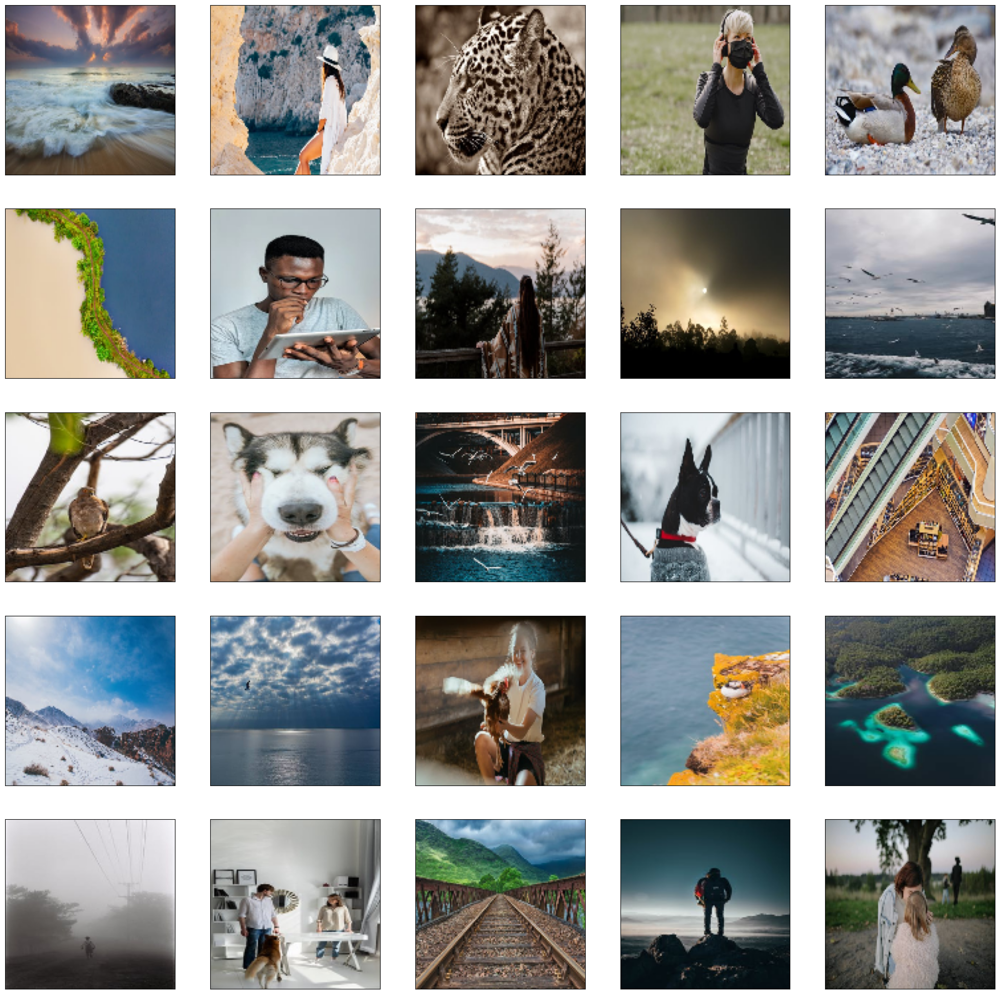

In [ ]:
import matplotlib.pyplot as plt

# @title Картинки без водяных знаков
plt.figure(figsize=(25, 25))
for i in range(25):
    plt.subplot(5, 5, i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    # Преобразуем картинку в формат RGB перед выводом
    plt.imshow(cv2.cvtColor(y_train[i], cv2.COLOR_BGR2RGB))
plt.show()

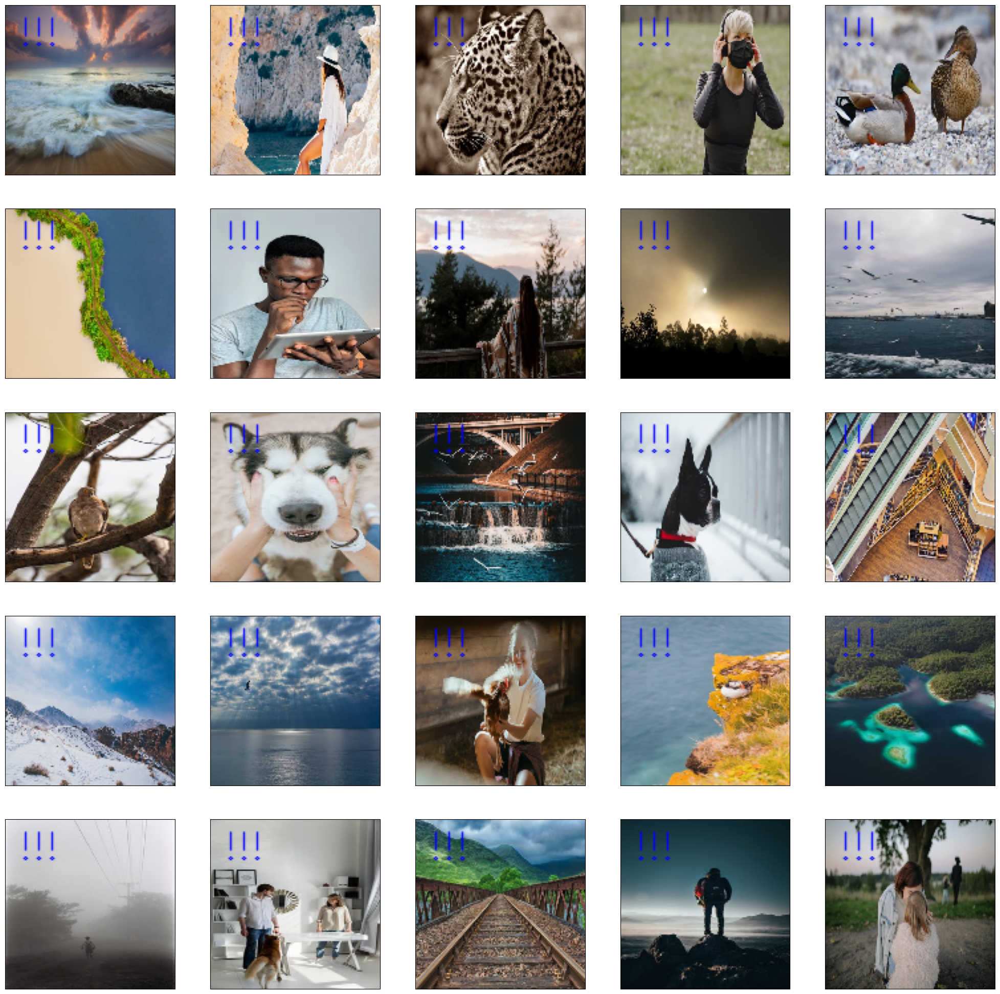

In [ ]:
# @title Картинки с водяными знаками
plt.figure(figsize=(25, 25))
for i in range(25):
    plt.subplot(5, 5, i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    # Преобразуем картинку в формат RGB перед выводом
    plt.imshow(cv2.cvtColor(X_train[i], cv2.COLOR_BGR2RGB))
plt.show()

# Очистка памяти

# Аугментация изображений

In [ ]:
# Аугментация
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow as tf

# Случайный выбор
import random

# @title Функции аугментации изображений

def randomBrightness(pic): # добавляем изображению случайную яркость от 1% до 20%
    return tf.image.random_brightness(pic, random.uniform(0.01, 0.2), 1).numpy()

def randomContrast(pic): # добавляем изображению случайную контрастность от 5% до 50%
    return tf.image.random_contrast(pic, 0.2, 0.7, 1).numpy()

# Добавочные функции
def randomFlip_lf(pic):
  return tf.image.random_flip_left_right(pic, 1).numpy()

def randomFlip_ud(pic):
  return tf.image.random_flip_up_down(pic, seed=1).numpy()

def randomHue(pic):
  return tf.image.random_hue(pic, 0.3, 1).numpy()

In [ ]:
# @title Функция аугментации
def augment(X_train, y_train):
  data_augmented_X = []
  data_augmented_y = []

  for image in X_train:
    data_augmented_X.append(randomBrightness(image))
    data_augmented_X.append(randomContrast(image))
    data_augmented_X.append(randomFlip_lf(image))
    data_augmented_X.append(randomFlip_ud(image))
    data_augmented_X.append(randomHue(image))

  for image in y_train:
    data_augmented_y.append(randomBrightness(image))
    data_augmented_y.append(randomContrast(image))
    data_augmented_y.append(randomFlip_lf(image))
    data_augmented_y.append(randomFlip_ud(image))
    data_augmented_y.append(randomHue(image))
  return data_augmented_X, data_augmented_y

In [ ]:
# @title Применение аугментации
data_augmented_X, data_augmented_y = augment(X_train, y_train)

# Рисую картинки после аугментации для демонстрации

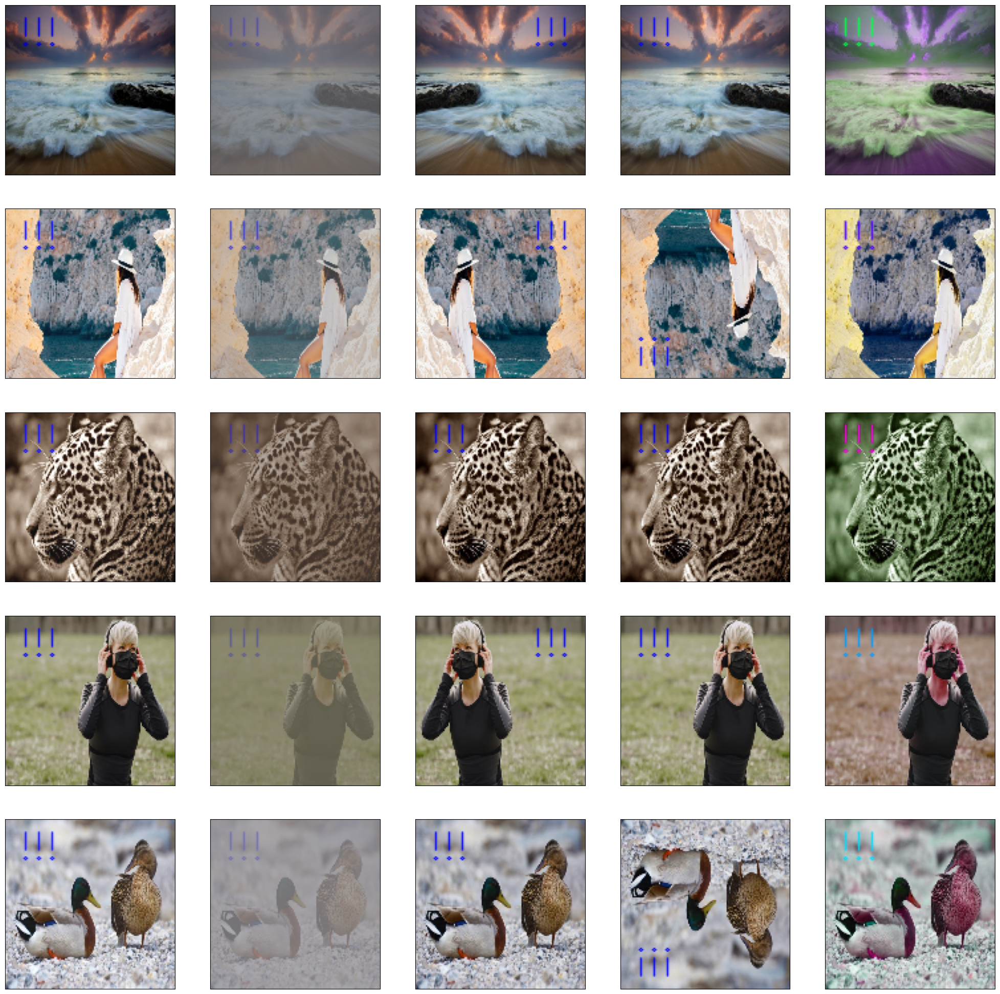

In [ ]:
# @title Аугментированные картинки с водяным знаком
import matplotlib.pyplot as plt
plt.figure(figsize=(25,25))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(cv2.cvtColor(data_augmented_X[i], cv2.COLOR_BGR2RGB))
plt.show()

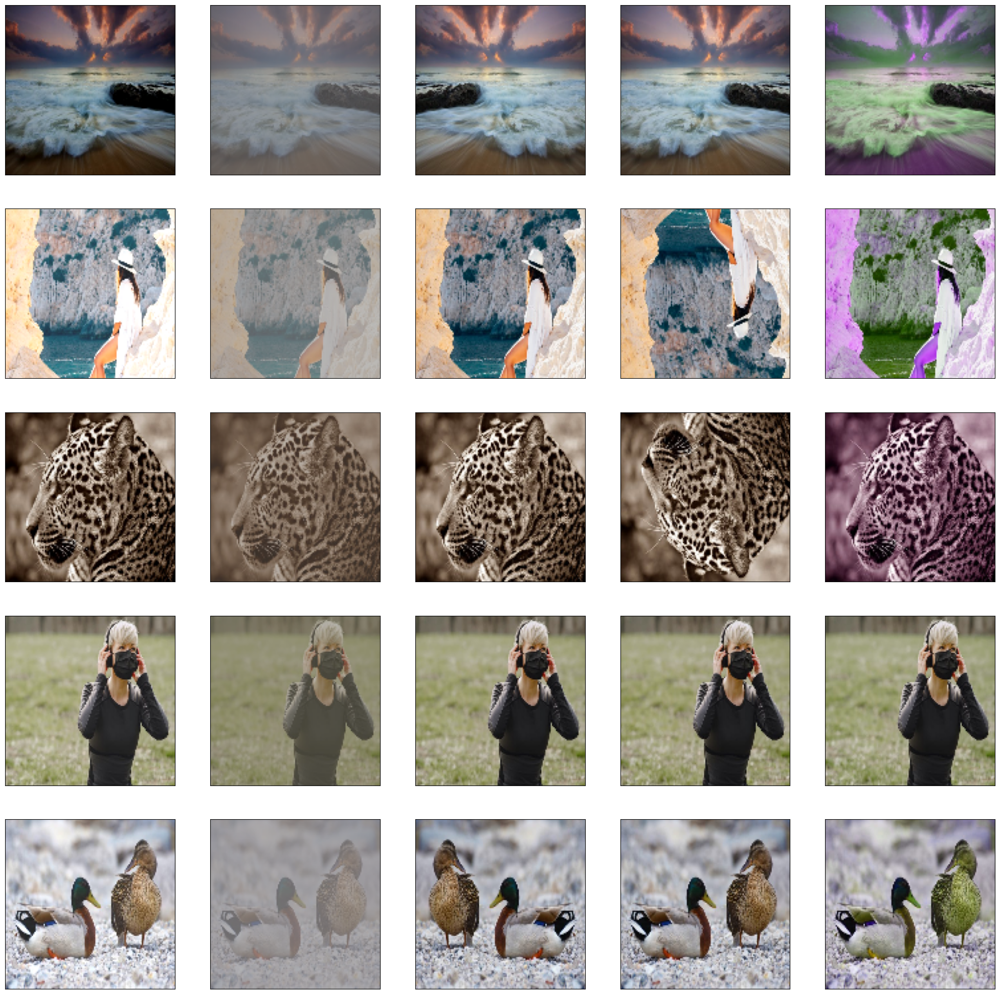

In [ ]:
# @title Аугментированные картинки без водняного знака
plt.figure(figsize=(25,25))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(cv2.cvtColor(data_augmented_y[i], cv2.COLOR_BGR2RGB))
plt.show()

# Подготовка картинок к обучению

# Настройка модели

In [ ]:
# @title Архитектура модели
# Слои
from keras.layers import Conv2D, MaxPooling2D, Dense, Input, UpSampling2D, Conv2DTranspose, BatchNormalization

# Конструктор модели
from keras.models import Model

# Оптимизатор
from keras.optimizers import Adam


def create_model(img_x, img_y, channel):
    inputs = Input(shape=(img_x, img_y, channel))

    # Кодировщик - сжимает входные данные в латентное пространство
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(inputs)
    x = MaxPooling2D((2, 2), padding='same')(x)
    x = BatchNormalization()(x)

    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    x = MaxPooling2D((2, 2), padding='same')(x)
    x = BatchNormalization()(x)

    x = Conv2D(16, (3, 3), activation='relu', padding='same')(x)
    h = MaxPooling2D((2, 2), padding='same')(x)

    # Декодировщик - реконструирует сжатое представление
    x = Conv2D(16, (3, 3), activation='relu', padding='same')(h)
    x = UpSampling2D((2, 2))(x)

    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    x = UpSampling2D((2, 2))(x)

    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = UpSampling2D((2, 2))(x)

    outputs = Conv2D(channel, (3, 3), activation='sigmoid', padding='same')(x)

    model = Model(inputs, outputs)
    model.compile(optimizer=Adam(learning_rate=1e-4),
                  loss='mse',  metrics=['acc'])
    return model

In [ ]:
# @title Создаем модель
watermark_auto_encoder = create_model(width, height, 3)

Схема сверточного автокодировщика:


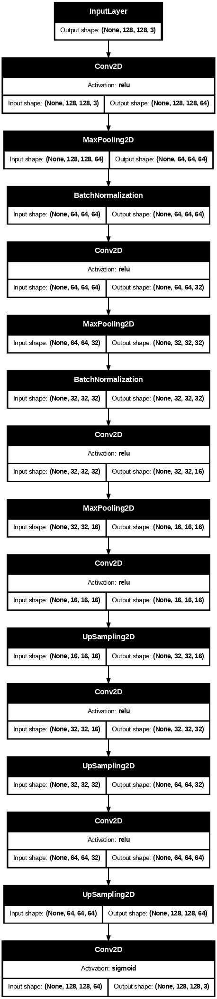

In [ ]:
# @title Рисуем схему модели
# Утилиты
from keras import utils

print('Схема сверточного автокодировщика:')
utils.plot_model(watermark_auto_encoder, show_shapes=True, dpi=70, show_layer_activations=True, expand_nested=True)

In [ ]:
# @title Настраиваем коллбеки
# Коллбэки
from keras.callbacks import EarlyStopping, ModelCheckpoint

early_stop = EarlyStopping(monitor='loss', patience=6, restore_best_weights=True)

model_name = "anomaly.weights.h5"

checkpoint = ModelCheckpoint(model_name,
                            monitor="val_loss",
                            mode="min",
                            save_best_only = True,
                            save_weights_only=True,
                            verbose=1)

In [ ]:
# @title Функция рисования
import matplotlib.pyplot as plt           # библиотека для рисования графиков
def plot_hist(history):
  acc = history['acc']              # данные о точности на обучающей выборке
  loss = history['loss']            # данные об ошибке на обучающей выборке
  epochs = range(1, len(acc) + 1)           # массив со значениями для оси абсцисс (Х)
  plt.plot(epochs, acc, 'r', label='Точность на обучающей выборке')          #  строим график точность на обучающей выборке
  plt.title('График точности на обучающей и проверочной выборках')           #  заголовок графика
  plt.legend()                                                               #  легенда графика
  plt.figure()                                                               #  создаем новую фигуру (полотно для графика)
  plt.plot(epochs, loss, 'r', label='Потери на обучающей выборке')           #  строим график потерь (ошибки) на обучающей выборке
  plt.title('График потерь на обучающей и проверочной выборках')             #  заголовок графика
  plt.legend()                                                               #  легенда графика
  plt.show()                                                                 #  рисуем график

# Обучение модели

In [ ]:
from keras.utils import Sequence
class CustomDataGen(Sequence):
  def __init__(self, chunks, batch_size) -> None:
     self.batch_size = batch_size
     self.chunks = chunks

  def __len__(self):
    return len(self.chunks) // self.batch_size

  def __getitem__(self, idx):
    # Формируем пакеты из ссылок путем среза длинной в batch_size и возвращаем пакет по индексу
    y_train, X_train = createPixelArr(self.chunks[idx*self.batch_size:(idx+1)*self.batch_size])

    # Аугментация
    data_augmented_X, data_augmented_y = augment(X_train, y_train)

    # Собрание всех картинок в выборке
    X_train = np.append(X_train, data_augmented_X, axis=0)
    y_train = np.append(y_train, data_augmented_y, axis=0)

    # Очистка памяти
    del data_augmented_X, data_augmented_y

    # Нормализация
    X_train = X_train.astype('float32') / 255.
    y_train = y_train.astype('float32') / 255.

    return X_train, y_train

In [ ]:
X_train = CustomDataGen(train_nonwatermarked, 32)

In [ ]:
history = watermark_auto_encoder.fit(X_train, batch_size=64, epochs=10, callbacks=[early_stop, checkpoint])

Epoch 1/10


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


389/389 ━━━━━━━━━━━━━━━━━━━━ 358s 844ms/step - acc: 0.4229 - loss: 0.0435
Epoch 2/10


/usr/local/lib/python3.10/dist-packages/keras/src/callbacks/model_checkpoint.py:206: UserWarning: Can save best model only with val_loss available, skipping.
  self._save_model(epoch=epoch, batch=None, logs=logs)


389/389 ━━━━━━━━━━━━━━━━━━━━ 333s 844ms/step - acc: 0.5690 - loss: 0.0270
Epoch 3/10
389/389 ━━━━━━━━━━━━━━━━━━━━ 333s 845ms/step - acc: 0.5868 - loss: 0.0257
Epoch 4/10
389/389 ━━━━━━━━━━━━━━━━━━━━ 334s 845ms/step - acc: 0.5957 - loss: 0.0251
Epoch 5/10
389/389 ━━━━━━━━━━━━━━━━━━━━ 335s 848ms/step - acc: 0.6095 - loss: 0.0245
Epoch 6/10
389/389 ━━━━━━━━━━━━━━━━━━━━ 381s 844ms/step - acc: 0.6140 - loss: 0.0245
Epoch 7/10
389/389 ━━━━━━━━━━━━━━━━━━━━ 382s 845ms/step - acc: 0.6174 - loss: 0.0245
Epoch 8/10
389/389 ━━━━━━━━━━━━━━━━━━━━ 332s 841ms/step - acc: 0.6229 - loss: 0.0240
Epoch 9/10
389/389 ━━━━━━━━━━━━━━━━━━━━ 383s 843ms/step - acc: 0.6291 - loss: 0.0238
Epoch 10/10
389/389 ━━━━━━━━━━━━━━━━━━━━ 382s 843ms/step - acc: 0.6330 - loss: 0.0238


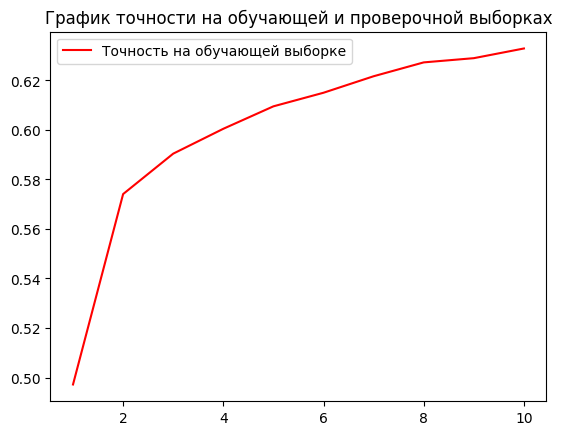

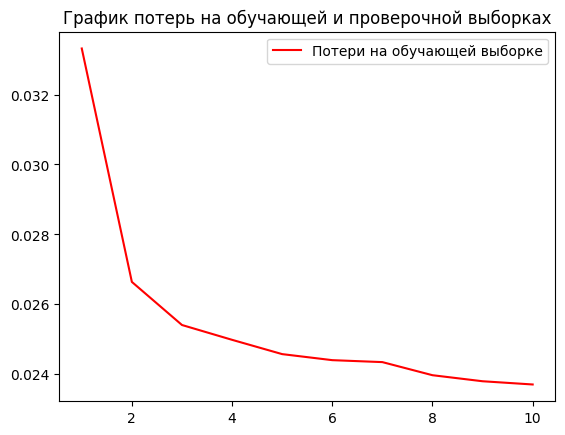

In [ ]:
plot_hist(history.history)

# Оценка модели

In [ ]:
class CustomDataGenTest(Sequence):
  def __init__(self, chunks, batch_size) -> None:
     self.batch_size = batch_size
     self.chunks = chunks

  def __len__(self):
    return len(self.chunks) // self.batch_size

  def __getitem__(self, idx):
    # Формируем пакеты из ссылок путем среза длинной в batch_size и возвращаем пакет по индексу
    test_y, test_x = createPixelArr(self.chunks[idx*self.batch_size:(idx+1)*self.batch_size])
    test_x = test_x.astype('float32') / 255.
    test_y = test_y.astype('float32') / 255.

    return test_x

In [ ]:
X_test = CustomDataGenTest(valid_nonwatermarked, 32)
result = watermark_auto_encoder.predict(X_test)

102/102 ━━━━━━━━━━━━━━━━━━━━ 8s 58ms/step


# Рисую получившиеся

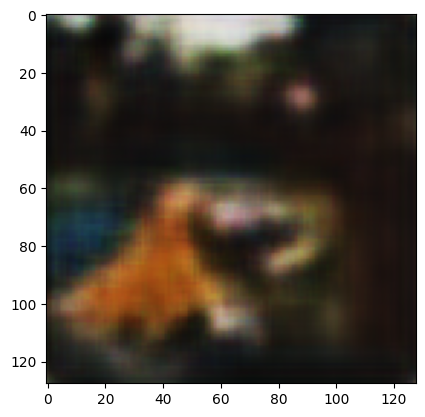

In [ ]:
# @title Вывод пробной картнки
plt.imshow(cv2.cvtColor(result[21], cv2.COLOR_BGR2RGB))

# Рисуем изображения №3


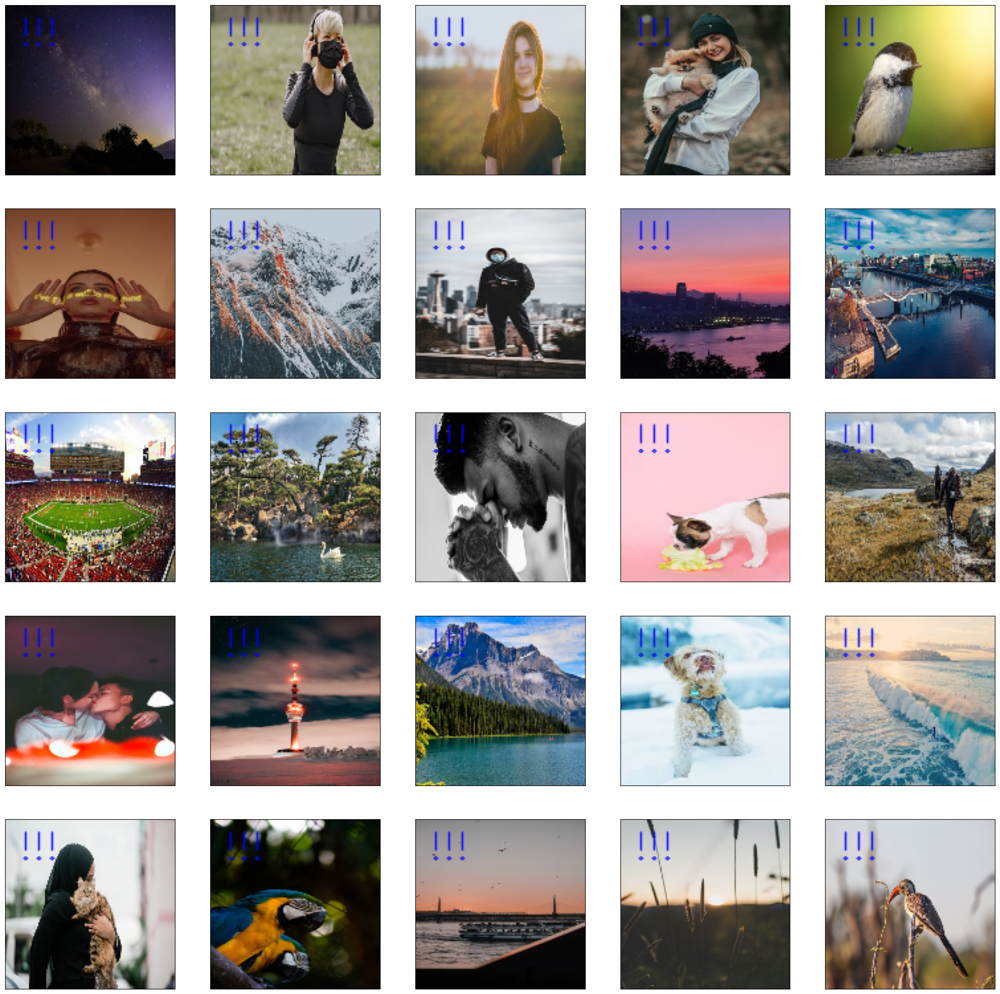

In [ ]:
# @title Рисуем исходные картинки с водяным знаком
plt.figure(figsize=(25,25))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(cv2.cvtColor(X_test[0][i].astype('float32'), cv2.COLOR_BGR2RGB))
plt.show()

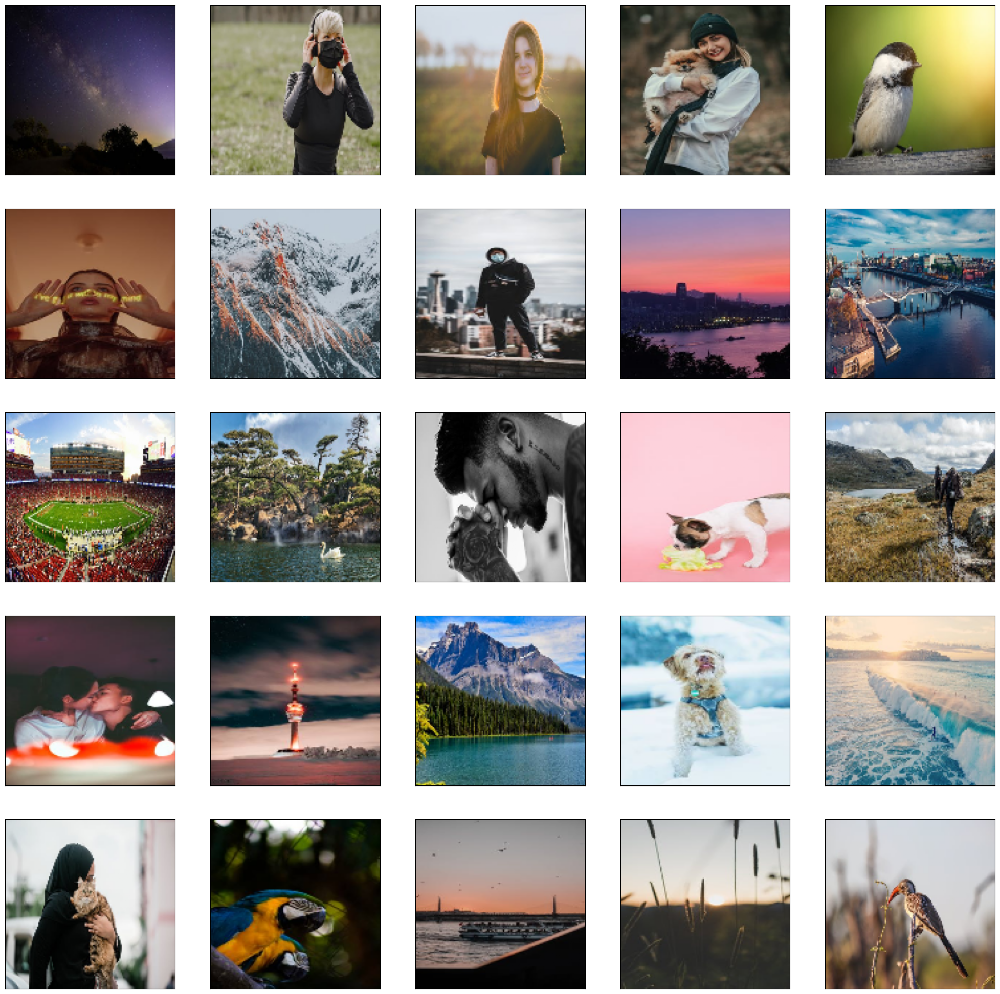

In [ ]:
# @title Рисуем исходные картинки без водяного знака
plt.figure(figsize=(25,25))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(cv2.cvtColor(y_test[i].astype('float32')/255, cv2.COLOR_BGR2RGB))
plt.show()

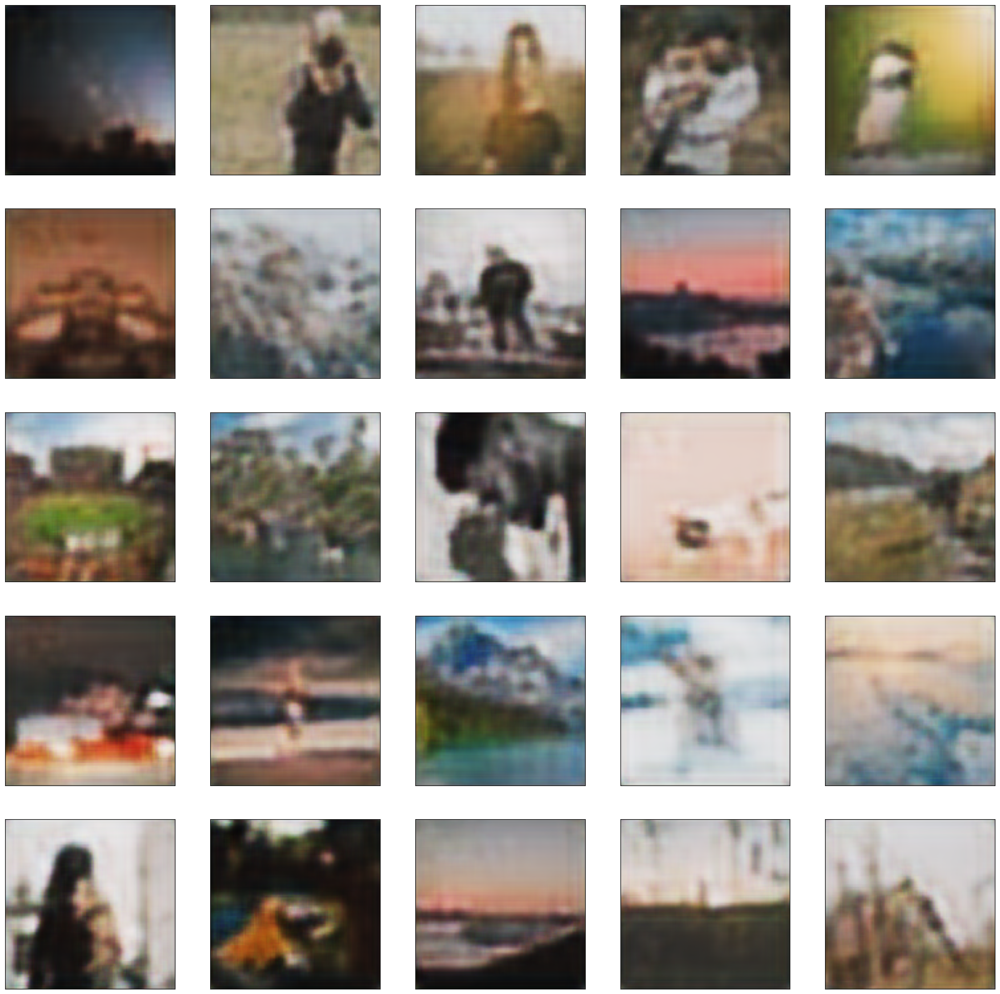

In [ ]:
# @title Рисуем предсказанные изображения
plt.figure(figsize=(25,25))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(cv2.cvtColor(result[i], cv2.COLOR_BGR2RGB))
plt.show()

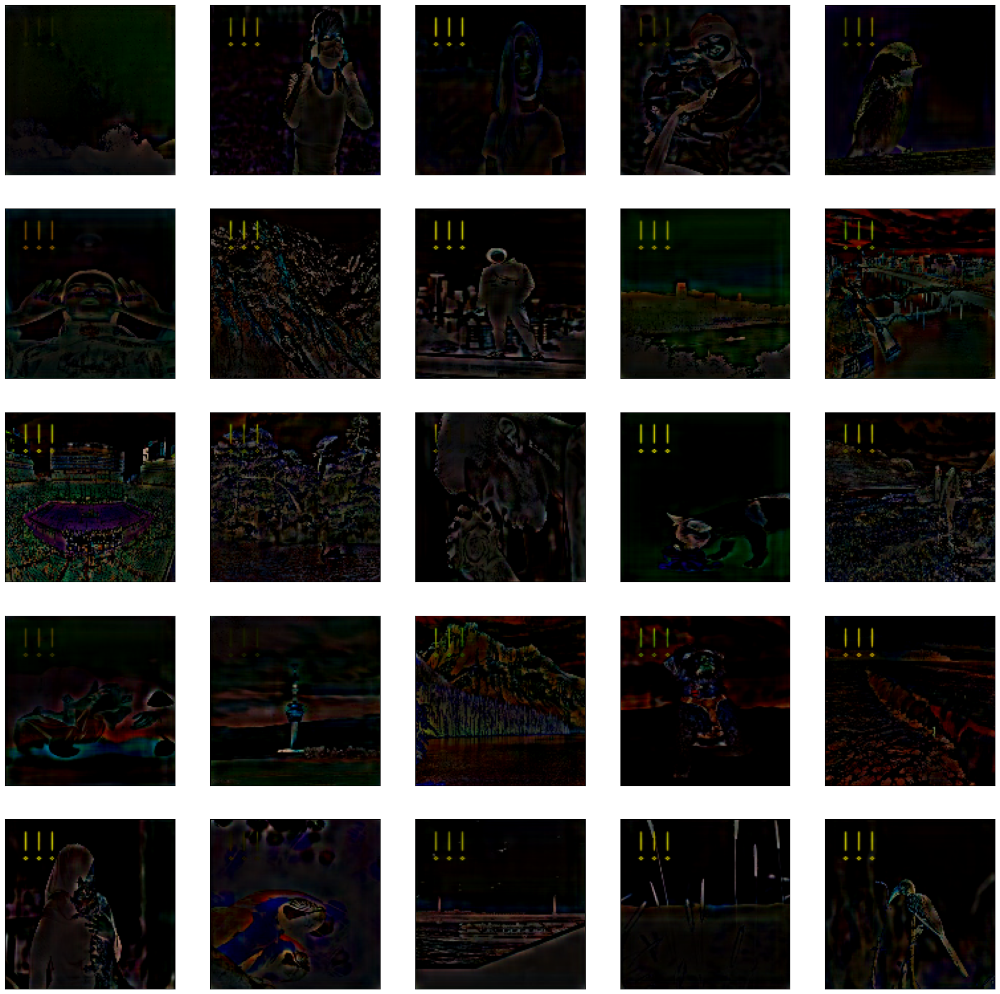

In [ ]:
# @title Рисую получившийся шум
sub = cv2.subtract(result[:X_test[0].shape[0]], X_test[0])

plt.figure(figsize=(25,25))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(cv2.cvtColor(sub[i], cv2.COLOR_BGR2RGB))
plt.show()